# Zero Shot Object Detection with OpenAI's CLIP

In this tutorial, we'll perform object detection on images using CLIP obtained from vector search. It will consist of 2 steps
User should put name of an object in query then
1. Vector Search will be performed to get images
2. Most similar image will be utilized to detect query object

In [1]:
# install required libraries
!pip install datasets torch transformers pyarrow lancedb

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 480.6/480.6 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.4/27.4 MB 18.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.5/30.5 MB 37.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 8.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 13.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 13.4 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2024.10.0
    Uninstalling fsspec-2024.10.0:
      Successfully uninstalled fsspec-2024.10.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.


### Download dataset

Let's start by downloading the dataset. We are using the <a ref= https://huggingface.co/datasets/jamescalam/image-text-demo> image-text-demo </a> from HuggingFace.

In [3]:
# pip install datasets
from datasets import load_dataset

data = load_dataset("jamescalam/image-text-demo", split="train", revision="180fdae")

# show dataset
data

The repository for jamescalam/image-text-demo contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/jamescalam/image-text-demo.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N] y


images.tgz:   0%|          | 0.00/37.8M [00:00<?, ?B/s]

Generating train split: 0 examples [00:00, ? examples/s]

Dataset({
    features: ['text', 'image'],
    num_rows: 21
})

The dataset includes 21 labelled images. We chose the 3rd image in the dataset, *butterfly landing on the nose of a cat*, to perform our object localization task. Let's have a look at it.

### Embed Images and their Captions

Now we'll embed images and their captions and their them in vectordb to query them first and then perform object detection on to it.

In [4]:
# install open-clip to use as embeddinng model
!pip install open_clip_torch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 3.8 MB/s eta 0:00:00


LancDB Embedding API has an integration with `open-clip`, which makes it easy to ingest embeddings and query data.

In [23]:
from lancedb.embeddings import get_registry

# get embedding model
embedding_model = (
    get_registry().get("open-clip").create(device="cpu")  # integration with clip
)


def get_embedding(text):
    """Get embedding of the text from the embedding model"""
    embedding = embedding_model.compute_query_embeddings(text, convert_to_tensor=True)
    return embedding

In [7]:
import pyarrow as pa
from lancedb.pydantic import LanceModel, Vector
import numpy as np
import lancedb

# Pydantic Schema for vectorDB


class Schema(LanceModel):
    vector: Vector(embedding_model.ndims()) = embedding_model.VectorField()
    image: bytes = embedding_model.SourceField()
    captions: str

In [8]:
import cv2
from pathlib import Path


# helper function to convert image into bytes format
def encode(img_path):
    img = cv2.imread(img_path)
    ext = Path(img_path).suffix
    img_encoded = cv2.imencode(ext, img)[1].tobytes()

    return img_encoded


# helper function to convert byte format image into PIL format
def decode(img_encoded):
    nparr = np.frombuffer(img_encoded, np.byte)
    img = cv2.imdecode(nparr, cv2.IMREAD_ANYCOLOR)

    return img

In [33]:
from io import BytesIO
import os


# helper function to ingest data in vectordb
def process_dataset():
    if not os.path.exists("dataset-images/"):
        os.makedirs("dataset-images/")

    for i in range(len(data)):
        image_path = f"dataset-images/{i}.png"
        # resizing and saving images in 720p considering available RAM
        resized_img = data[i]["image"].resize((1080, 720))
        resized_img.save(image_path, format="PNG")

        binary_image = encode(image_path)

        image = pa.array([binary_image], type=pa.binary())
        caption = pa.array([data[i]["text"]], type=pa.string())
        embedding = pa.array(
            [list(get_embedding(str(data[i]["text"])))[0]], type=pa.list_(pa.float32())
        )

        yield pa.RecordBatch.from_arrays(
            [embedding, image, caption], ["vector", "image", "captions"]
        )

In [34]:
# create db and ingest data in table

db = lancedb.connect("dataset")
tbl = db.create_table("table", schema=Schema, mode="overwrite")
tbl.add(process_dataset())

In [35]:
# view ingested dataset
tbl.head()

pyarrow.Table
vector: fixed_size_list<item: float>[512] not null
  child 0, item: float
image: binary not null
captions: string not null
----
vector: [[[-0.04580994,-0.052125763,-0.068520576,-0.026972912,0.034301277,...,-0.050645325,-0.035088293,-0.05719093,-0.022261364,0.03476377],[-0.09012573,-0.019105539,-0.02192812,-0.048061196,0.009456407,...,-0.03788309,-0.048279405,0.0016447826,-0.052010093,0.04027523],[0.008432623,0.00045157515,0.022994662,0.029559212,-0.027057419,...,0.054864928,-0.013266184,-0.010450753,0.030110497,0.014676921],[0.030161098,-0.0071079307,0.072282135,-0.06842846,0.03423578,...,0.068531424,0.008669447,-0.0018202097,0.007394255,0.066655],[-0.019529104,0.00020045726,0.00556846,-0.033472795,-0.03985409,...,0.10117824,0.0037390417,0.058115523,-0.013279541,0.036096316]]]
image: [[89504E470D0A1A0A0000000D4948445200000438000002D00802000000FAB5570D00002000494441547801ACC1D176DD089218C1CC02B57E9BFFFF529FDD11516900E495C86EB5BD3E7684CCBFF84A51FE28C19949E2D101F2850E7F2628C

### Query

In [36]:
# search for object, detection will be performed on the same
query = "kitten"

# query
hit_lists = tbl.search(query).metric("cosine").limit(1).to_list()

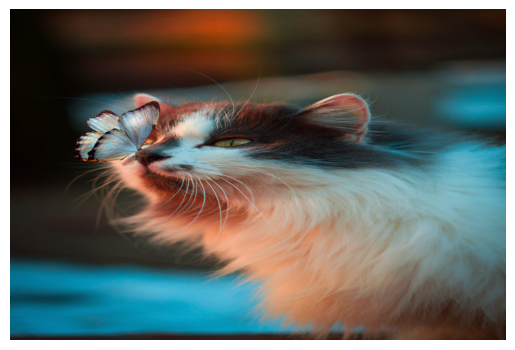

In [37]:
import io
from PIL import Image
import matplotlib.pyplot as plt


def show_image(image):
    stream = io.BytesIO(image)
    plt.imshow(Image.open(stream))
    plt.axis("off")
    plt.show()


show_image(hit_lists[0]["image"])

### Break Image into Equal Patches

The first step consists of transforming our image into a tensor.

In [38]:
# using resulted image from query
stream = io.BytesIO(hit_lists[0]["image"])
resultant_img = Image.open(stream)

In [39]:
from torchvision import transforms

# transform the image into tensor
transform = transforms.ToTensor()

img = transform(resultant_img)
img.data.shape

torch.Size([3, 720, 1080])

The generated tensor has $3$ color channels, a height of $720$, and width of $1080$ ($1080x720 pixels$). We now want to add an extra dimension, which will be needed for later calculations. We can use the `unfold` function.

In [40]:
# add extra dimension for later calculations
patches = img.data.unfold(0, 3, 3)
patches.shape

torch.Size([1, 720, 1080, 3])

We can now break the image into patches. More precisely, we want to break the image into $64x64$ pixels patches. We start by breaking it horizontally, meaning that we will end up with an image composed of $11$ patches of $64$ pixels in height.

In [41]:
# break the image into patches (in height dimension)
patch = 64

patches = patches.unfold(1, patch, patch)
patches.shape

torch.Size([1, 11, 1080, 3, 64])

We can visualize it below:

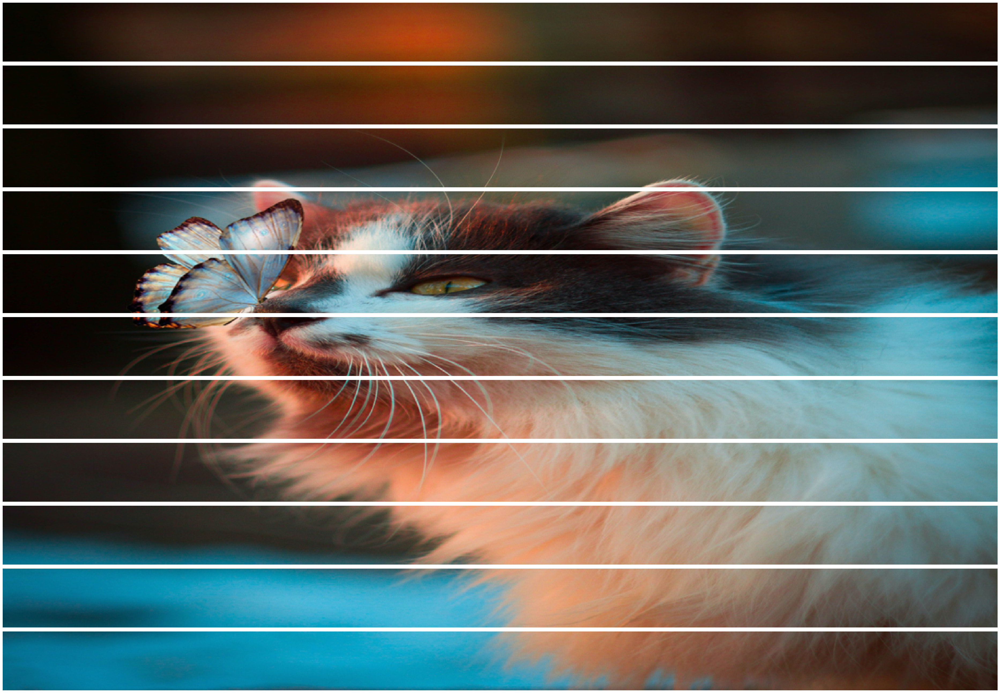

In [42]:
import matplotlib.pyplot as plt

X = patches.shape[1]

fig, ax = plt.subplots(X, 1, figsize=(40, 26))
# loop through each strip and display
for x in range(X):
    ax[x].imshow(patches[0, x].permute(2, 0, 1))
    ax[x].axis("off")
fig.tight_layout()
plt.show()

We can now use the `unfold` function again to break the image vertically. After this operation, we will get an image composed of $11x16$ patches of $64x64$ pixels.

In [43]:
# break the image into patches (in width dimension)
patches = patches.unfold(2, 64, 64)
patches.shape

torch.Size([1, 11, 16, 3, 64, 64])

We can visualize it below:

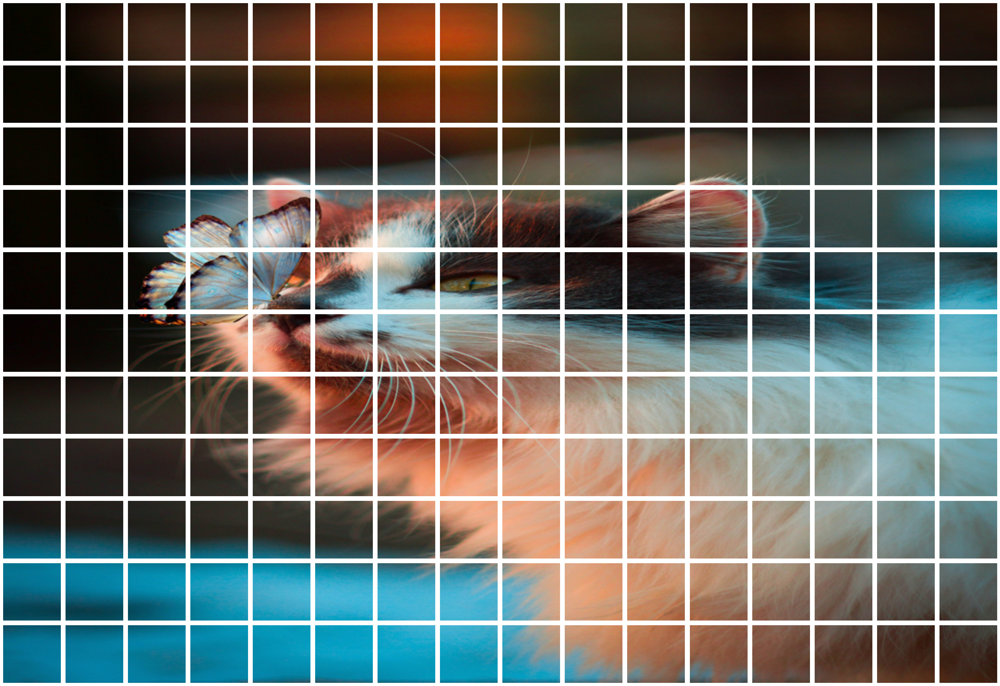

In [44]:
import matplotlib.pyplot as plt

X = patches.shape[1]
Y = patches.shape[2]

fig, ax = plt.subplots(X, Y, figsize=(Y * 2, X * 2))
for x in range(X):
    for y in range(Y):
        ax[x, y].imshow(patches[0, x, y].permute(1, 2, 0))
        ax[x, y].axis("off")
fig.tight_layout()
plt.show()

### Process Patches using CLIP

The first step is done. We are now almost ready to process those patches using CLIP. Before doing it, we might want to work through these patches by grouping them into a 4x4 window.


Approach used to process these patches is same as YOLO do for processing a image while detection by keeping a window size and strides and then processing each of it.

Let's visualize the first patch.

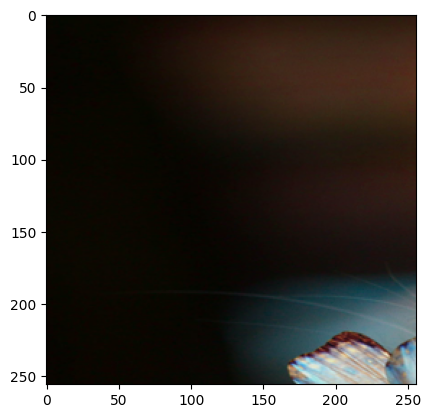

In [45]:
import torch

# set the 4x4 window
window = 4

big_patch = torch.zeros(patch * window, patch * window, 3)
patch_batch = patches[0][:window][:window]

# visualize patch
for y in range(window):
    for x in range(window):
        big_patch[
            y * patch : (y + 1) * patch, x * patch : (x + 1) * patch, :
        ] = patch_batch[y, x].permute(1, 2, 0)

plt.imshow(big_patch)
plt.show()

In [46]:
patches.shape

torch.Size([1, 11, 16, 3, 64, 64])

This is now a patch consisting of 4x4 smaller patches.

We can repeat this process by "sliding" the 4x4 window over the full image. We set the stride, i.e., the number of steps the window moves, to $1$ i.e. strides.

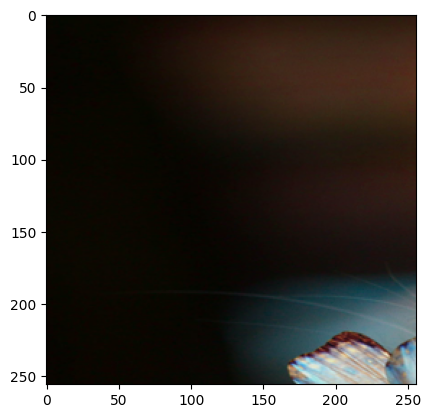

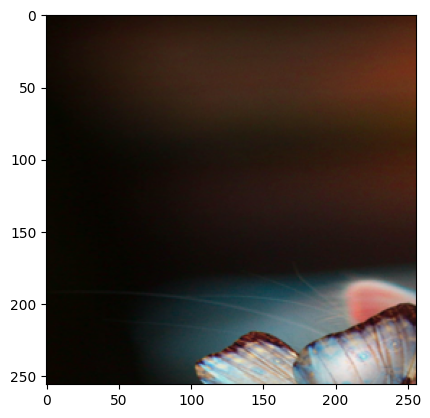

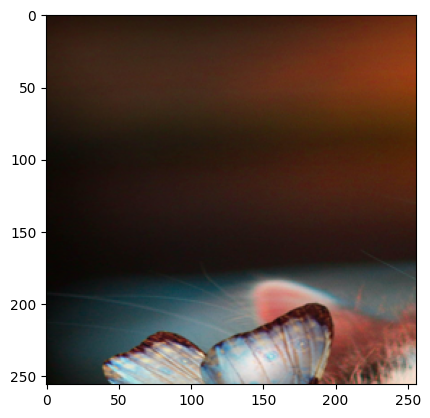

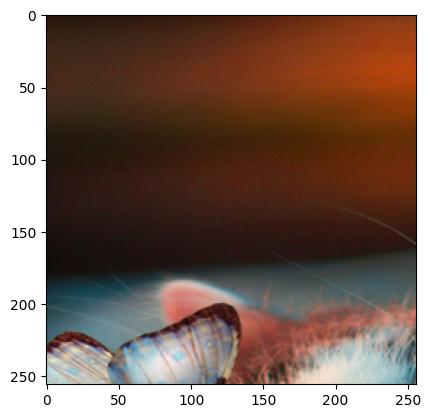

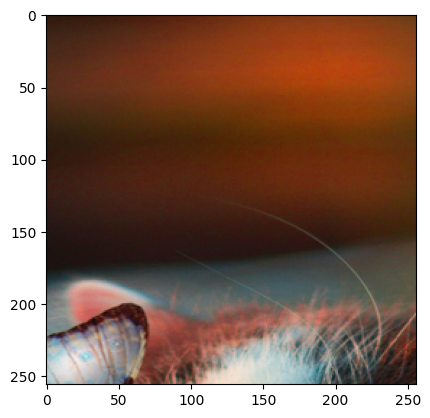

...

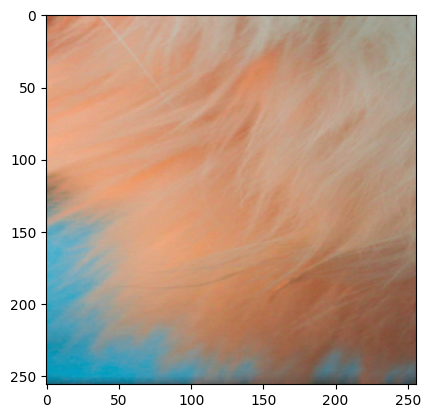

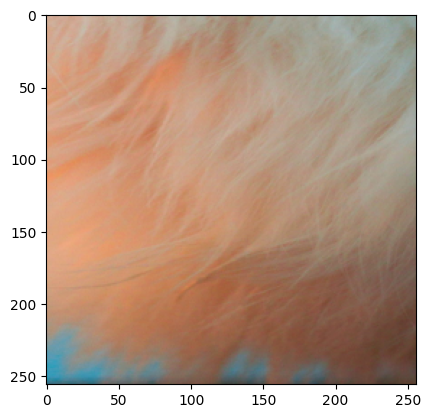

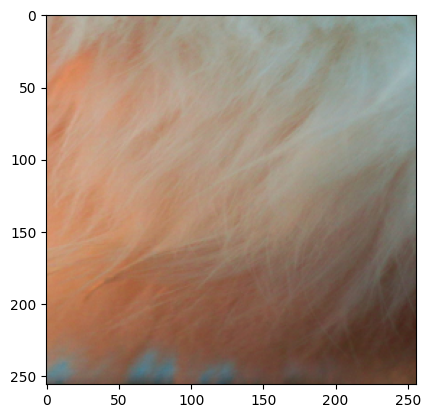

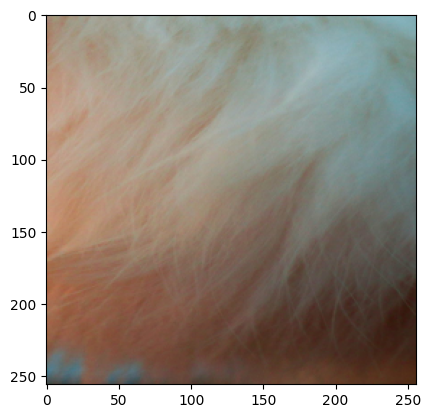

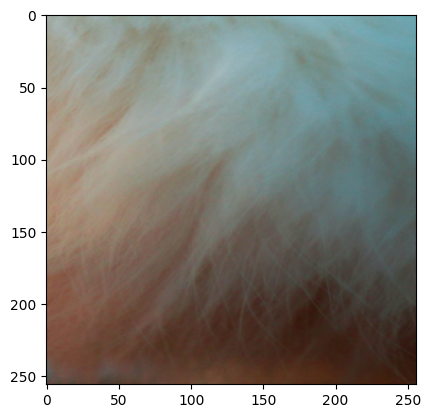

In [47]:
window = 4
stride = 1

# window slides from top to bottom
for Y in range(0, patches.shape[1] - window + 1, stride):
    # window slides from left to right
    for X in range(0, patches.shape[2] - window + 1, stride):
        # initialize an empty big_patch array
        big_patch = torch.zeros(patch * window, patch * window, 3)

        # this gets the current batch of patches that will make big_batch
        patch_batch = patches[0, Y : Y + window, X : X + window]
        # loop through each patch in current batch
        for y in range(patch_batch.shape[1]):
            for x in range(patch_batch.shape[0]):
                # add patch to big_patch
                big_patch[
                    y * patch : (y + 1) * patch, x * patch : (x + 1) * patch, :
                ] = patch_batch[y, x].permute(1, 2, 0)
        # display current big_patch
        plt.imshow(big_patch)
        plt.show()

We need now to process these through CLIP and calculate the similarity between the patch and a prompt. Our prompt will be same as we query which image search. Let's first define our processor and model CLIP and move it to device, if possible.

In [48]:
from transformers import CLIPProcessor, CLIPModel
import torch

# define processor and model
model_id = "openai/clip-vit-base-patch32"

processor = CLIPProcessor.from_pretrained(model_id)
model = CLIPModel.from_pretrained(model_id)

# move model to device if possible
device = "cuda" if torch.cuda.is_available() else "cpu"

model.to(device)
print("Model Loaded on", device)

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

Model Loaded on cpu


Now, we can add a step to the previous operation, i.e., we calculate similarity scores for each patch (`scores`) and the number of time the window slides over each patch (`runs`). To do that, we are trasmitting to the CLIP model the image, and the prompt, which is "a fluffy cat".

In [49]:
window = 4
stride = 1

scores = torch.zeros(patches.shape[1], patches.shape[2])
runs = torch.ones(patches.shape[1], patches.shape[2])

for Y in range(0, patches.shape[1] - window + 1, stride):
    for X in range(0, patches.shape[2] - window + 1, stride):
        big_patch = torch.zeros(patch * window, patch * window, 3)
        patch_batch = patches[0, Y : Y + window, X : X + window]
        for y in range(window):
            for x in range(window):
                big_patch[
                    y * patch : (y + 1) * patch, x * patch : (x + 1) * patch, :
                ] = patch_batch[y, x].permute(1, 2, 0)
        # we preprocess the image and class label with the CLIP processor
        inputs = processor(
            images=big_patch,  # big patch image sent to CLIP
            return_tensors="pt",  # tell CLIP to return pytorch tensor
            text=query,  # class label sent to CLIP
            padding=True,
        ).to(
            device
        )  # move to device if possible

        # calculate and retrieve similarity score
        score = model(**inputs).logits_per_image.item()
        # sum up similarity scores from current and previous big patches
        # that were calculated for patches within the current window
        scores[Y : Y + window, X : X + window] += score
        # calculate the number of runs on each patch within the current window
        runs[Y : Y + window, X : X + window] += 1

It looks like you are trying to rescale already rescaled images. If the input images have pixel values between 0 and 1, set `do_rescale=False` to avoid rescaling them again.


We then want to divide the total score (`scores`) by the number of time the window slided over the patch (`runs`) to get an average score for each patch.

In [50]:
import numpy as np

# average score for each patch
scores /= runs

The initial visual is not very useful...

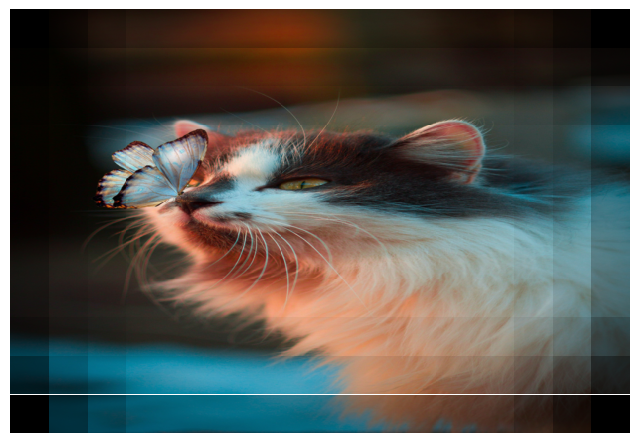

In [51]:
# transform the patches tensor
adj_patches = patches.squeeze(0).permute(3, 4, 2, 0, 1)
# normalize scores
scores = (scores - scores.min()) / (scores.max() - scores.min())
# multiply patches by scores
adj_patches = adj_patches * scores
# rotate patches to visualize
adj_patches = adj_patches.permute(3, 4, 2, 0, 1)

Y = adj_patches.shape[0]
X = adj_patches.shape[1]

fig, ax = plt.subplots(Y, X, figsize=(X * 0.5, Y * 0.5))
for y in range(Y):
    for x in range(X):
        ax[y, x].imshow(adj_patches[y, x].permute(1, 2, 0))
        ax[y, x].axis("off")
        ax[y, x].set_aspect("equal")
plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

The resulting tensor is characterized by a smooth gradient of scores and little-to-no impact from the scores on our visual. That is why (1) we are going to clip the score's interval edges for each patch so that they are around the average score, and (2) normalize scores for each patch.

Using the `numpy.clip()` function, we can set all the scores below the average score equal to $0$ while keeping those higher than the average score as they are.

We are running the same operation 3 times as it seems to give us better results.

In [52]:
# clip the scores' interval edges
for _ in range(1):
    scores = np.clip(scores - scores.mean(), 0, np.inf)

scores

tensor([[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.0533, 0.0526, 0.0526, 0.0524, 0.0523, 0.0516,
         0.0508, 0.0499, 0.0497, 0.0511, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0782, 0.1300, 0.1291, 0.1289, 0.1287, 0.1285, 0.1281,
         0.1276, 0.1271, 0.1271, 0.1284, 0.0769, 0.0000, 0.0000],
        [0.0000, 0.0529, 0.1298, 0.1704, 0.1694, 0.1692, 0.1689, 0.1689, 0.1688,
         0.1687, 0.1684, 0.1685, 0.1697, 0.1292, 0.0532, 0.0000],
        [0.0000, 0.0537, 0.1298, 0.1704, 0.1689, 0.1684, 0.1684, 0.1683, 0.1683,
         0.1684, 0.1682, 0.1684, 0.1693, 0.1288, 0.0526, 0.0000],
        [0.0000, 0.0536, 0.1298, 0.1702, 0.1688, 0.1679, 0.1676, 0.1673, 0.1672,
         0.1675, 0.1676, 0.1680, 0.1687, 0.1282, 0.0518, 0.0000],
        [0.0000, 0.0542, 0.1305, 0.1710, 0.1698, 0.1690, 0.1687, 0.1685, 0.1683,
         0.1681, 0.1678, 0.1678, 0.16

After, we normalize the scores using the min-max normalization. For every tensor, the minimum value is transformed into a 0, the maximum value into a 1, and every other value into a decimal between 0 and 1.

In [53]:
# normalize scores
scores = (scores - scores.min()) / (scores.max() - scores.min())
scores

tensor([[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.3099, 0.3059, 0.3059, 0.3048, 0.3042, 0.3000,
         0.2954, 0.2900, 0.2888, 0.2969, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.4544, 0.7557, 0.7505, 0.7494, 0.7478, 0.7470, 0.7446,
         0.7420, 0.7386, 0.7386, 0.7463, 0.4468, 0.0000, 0.0000],
        [0.0000, 0.3076, 0.7546, 0.9902, 0.9844, 0.9832, 0.9816, 0.9817, 0.9811,
         0.9804, 0.9786, 0.9794, 0.9862, 0.7512, 0.3093, 0.0000],
        [0.0000, 0.3120, 0.7545, 0.9903, 0.9819, 0.9786, 0.9786, 0.9781, 0.9783,
         0.9790, 0.9779, 0.9787, 0.9842, 0.7488, 0.3058, 0.0000],
        [0.0000, 0.3117, 0.7543, 0.9892, 0.9811, 0.9759, 0.9740, 0.9722, 0.9720,
         0.9737, 0.9740, 0.9763, 0.9808, 0.7449, 0.3012, 0.0000],
        [0.0000, 0.3150, 0.7588, 0.9938, 0.9872, 0.9824, 0.9804, 0.9792, 0.9781,
         0.9772, 0.9756, 0.9752, 0.97

### Visualize Results

These scores are telling us if a given patch contains "a fluffy cat" or not. The higher the score, the more the probability that the cat is localized in that patch.

We now want to visualize those scores, i.e., the localized object, on the original image. Scores equal to zero will be represented by black patches, so that the localized object can be clearly seen.

To do that, we can multiply our scores by the patches. This requires that scores and patches have the same shape.

In [54]:
scores.shape, patches.shape

(torch.Size([11, 16]), torch.Size([1, 11, 16, 3, 64, 64]))

Given they do not have the same shape, we can transform the patches shape using `squeeze` and `permute`. Squeeze reduce the dimensionality, while permute rotates the tensor.

In [55]:
# transform the patches tensor
adj_patches = patches.squeeze(0).permute(3, 4, 2, 0, 1)
adj_patches.shape

torch.Size([64, 64, 3, 11, 16])

We can now multiply patches to scores.

In [56]:
# multiply patches by scores
adj_patches = adj_patches * scores

Before plotting the localized object, we can rotate the patch tensor again to make our life easier ahead.

In [57]:
# rotate patches to visualize
adj_patches = adj_patches.permute(3, 4, 2, 0, 1)
adj_patches.shape

torch.Size([11, 16, 3, 64, 64])

We can now visualize the localized object. We are expecting to visualize the cat only.

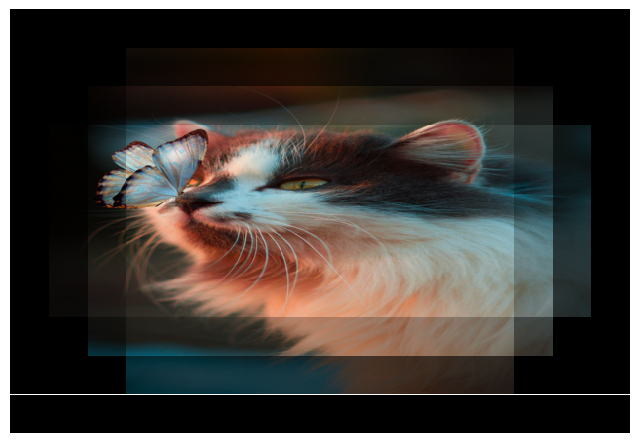

In [58]:
Y = adj_patches.shape[0]
X = adj_patches.shape[1]

fig, ax = plt.subplots(Y, X, figsize=(X * 0.5, Y * 0.5))
for y in range(Y):
    for x in range(X):
        ax[y, x].imshow(adj_patches[y, x].permute(1, 2, 0))
        ax[y, x].axis("off")
        ax[y, x].set_aspect("equal")
plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

In [59]:
scores /= runs
for _ in range(3):
    scores = np.clip(scores - scores.mean(), 0, np.inf)
# normalize scores
scores = (scores - scores.min()) / (scores.max() - scores.min())

In [60]:
# adjust patches
adj_patches = patches.squeeze(0).permute(3, 4, 2, 0, 1) * scores
adj_patches = adj_patches.permute(3, 4, 2, 0, 1)

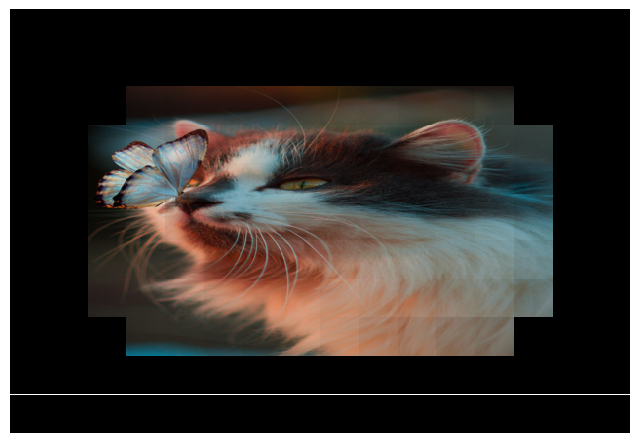

In [61]:
Y = adj_patches.shape[0]
X = adj_patches.shape[1]

fig, ax = plt.subplots(Y, X, figsize=(X * 0.5, Y * 0.5))
for y in range(Y):
    for x in range(X):
        ax[y, x].imshow(adj_patches[y, x].permute(1, 2, 0))
        ax[y, x].axis("off")
        ax[y, x].set_aspect("equal")
plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

## CLIP for Object Detection

Localization is one step towards object detection, where we might expect to detect multiple objects.

We can extend our current localization code quite easily to achieve this, we just add an extra layer of logic. But, before we do anything, we need to rethink our localization visual — this would be hard to represent when displaying two or more objects.

The typical approach to this is to create a "bounding box".

The scores we are using are from the last run, with which we localized the butterly. Therefore, we are going to build the a bounding box around the butterfly first. We want the bounding box to focus as much as possible on the butterly only, nothing else.

Scores higher than $0.5$ seem to give us a more precise bounding box. We have then defined 'detection', which gives us *True* when the score is higher than $0.5$ (i.e.,non-zero positions), and *False* otherwise.

In [62]:
# scores higher than 0.5
detection = scores > 0.5

We can now detect the non-zero *positions* with the `np.nonzero` function.  These represent the co-ordinates of our patches with scores $>0.5$.

In [63]:
# non-zero positions
np.nonzero(detection)

tensor([[ 2,  3],
        [ 2,  4],
        [ 2,  5],
        [ 2,  6],
        [ 2,  7],
        [ 2,  8],
        [ 2,  9],
        [ 2, 10],
        [ 2, 11],
        [ 2, 12],
        [ 3,  2],
        [ 3,  3],
        [ 3,  4],
        [ 3,  5],
        [ 3,  6],
        [ 3,  7],
        [ 3,  8],
        [ 3,  9],
        [ 3, 10],
        [ 3, 11],
        [ 3, 12],
        [ 3, 13],
        [ 4,  2],
        [ 4,  3],
        [ 4,  4],
        [ 4,  5],
        [ 4,  6],
        [ 4,  7],
        [ 4,  8],
        [ 4,  9],
        [ 4, 10],
        [ 4, 11],
        [ 4, 12],
        [ 4, 13],
        [ 5,  2],
        [ 5,  3],
        [ 5,  4],
        [ 5,  5],
        [ 5,  6],
        [ 5,  7],
        [ 5,  8],
        [ 5,  9],
        [ 5, 10],
        [ 5, 11],
        [ 5, 12],
        [ 5, 13],
        [ 6,  2],
        [ 6,  3],
        [ 6,  4],
        [ 6,  5],
        [ 6,  6],
        [ 6,  7],
        [ 6,  8],
        [ 6,  9],
        [ 6, 10],
        [ 

The first column represents non-zero row positions, while the second column non-zero column positions. We can visualize the above co-ordinates as follows:


The bounding box we want to design, will be around the area of interest.

We can build it by calculating its corners, which correspond to the minimum and maximum $x$ and $y$ co-ordinates, i.e., $(x_{min}, y_{min})$, $(x_{max}, y_{min})$, $(x_{min}, y_{max})$, and $(x_{max}, y_{max})$.


In [64]:
y_min, y_max = (
    np.nonzero(detection)[:, 0].min().item(),
    np.nonzero(detection)[:, 0].max().item() + 1,
)
y_min, y_max

(2, 9)

In [65]:
x_min, x_max = (
    np.nonzero(detection)[:, 1].min().item(),
    np.nonzero(detection)[:, 1].max().item() + 1,
)
x_min, x_max

(2, 14)

These give us the bounding box corner co-ordinates based on patches rather than pixel values. To get the pixel co-ordinates we need to multiply by the `patch` size.

In [66]:
y_min *= patch
y_max *= patch
x_min *= patch
x_max *= patch
x_min, y_min

(128, 128)

We use `(y_max - y_min)` and `(x_max - x_min)` to calculate the height and width of the bounding box respectively...

In [67]:
height = y_max - y_min
width = x_max - x_min

height, width

(448, 768)

Given our patches are $64x64$ pixels

We should be now be able to visualize the bounding box on our image. We are going to use 'matplotlib'. This need the image's color channel to be as last in the image's shape.

In [68]:
# image shape
img.data.numpy().shape

(3, 720, 1080)

In our case, this is in the first position. We then need to move it to end. We are using 'moveaxis' to do that.

In [69]:
# move color channel to final dim
image = np.moveaxis(img.data.numpy(), 0, -1)
image.shape

(720, 1080, 3)

We can now plot the image.

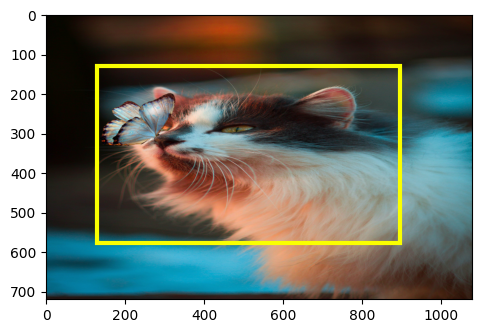

In [70]:
import matplotlib.patches as patches

fig, ax = plt.subplots(figsize=(Y * 0.5, X * 0.5))

ax.imshow(image)

# Create a Rectangle patch
rect = patches.Rectangle(
    (x_min, y_min), width, height, linewidth=3, edgecolor="#FAFF00", facecolor="none"
)

# Add the patch to the Axes
ax.add_patch(rect)

plt.show()

We can repeat this process for a number of objects that we'd like CLIP to detect. let's put everything we've done so far in a few helper functions, then create a new function called `detect` to handle the detection of multiple objects and visualization of the bounding boxes.

In [71]:
from tqdm.auto import tqdm
import matplotlib.patches as patches

colors = ["#8CF1FF"]


def get_patches(img, patch_size=64):
    # add extra dimension for later calculations
    img_patches = img.data.unfold(0, 3, 3)
    # break the image into patches (in height dimension)
    img_patches = img_patches.unfold(1, patch_size, patch_size)
    # break the image into patches (in width dimension)
    img_patches = img_patches.unfold(2, patch_size, patch_size)
    return img_patches


def get_scores(img_patches, prompt, window=4, stride=1):
    # initialize scores and runs arrays
    scores = torch.zeros(img_patches.shape[1], img_patches.shape[2])
    runs = torch.ones(img_patches.shape[1], img_patches.shape[2])

    # iterate through patches
    for Y in range(0, img_patches.shape[1] - window + 1, stride):
        for X in range(0, img_patches.shape[2] - window + 1, stride):
            # initialize array to store big patches
            big_patch = torch.zeros(patch * window, patch * window, 3)
            # get a single big patch
            patch_batch = img_patches[0, Y : Y + window, X : X + window]
            # iteratively build all big patches
            for y in range(window):
                for x in range(window):
                    big_patch[
                        y * patch : (y + 1) * patch, x * patch : (x + 1) * patch, :
                    ] = patch_batch[y, x].permute(1, 2, 0)
            inputs = processor(
                images=big_patch,  # image trasmitted to the model
                return_tensors="pt",  # return pytorch tensor
                text=prompt,  # text trasmitted to the model
                padding=True,
            ).to(
                device
            )  # move to device if possible

            score = model(**inputs).logits_per_image.item()
            # sum up similarity scores
            scores[Y : Y + window, X : X + window] += score
            # calculate the number of runs
            runs[Y : Y + window, X : X + window] += 1
    # calculate average scores
    scores /= runs
    # clip scores
    for _ in range(3):
        scores = np.clip(scores - scores.mean(), 0, np.inf)
    # normalize scores
    scores = (scores - scores.min()) / (scores.max() - scores.min())
    return scores


def get_box(scores, patch_size=64, threshold=0.5):
    detection = scores > threshold
    # find box corners
    y_min, y_max = (
        np.nonzero(detection)[:, 0].min().item(),
        np.nonzero(detection)[:, 0].max().item() + 1,
    )
    x_min, x_max = (
        np.nonzero(detection)[:, 1].min().item(),
        np.nonzero(detection)[:, 1].max().item() + 1,
    )
    # convert from patch co-ords to pixel co-ords
    y_min *= patch_size
    y_max *= patch_size
    x_min *= patch_size
    x_max *= patch_size
    # calculate box height and width
    height = y_max - y_min
    width = x_max - x_min
    return x_min, y_min, width, height


def detect(prompts, img, patch_size=64, window=4, stride=1, threshold=0.5):
    # build image patches for detection
    img_patches = get_patches(img, patch_size)
    # convert image to format for displaying with matplotlib
    image = np.moveaxis(img.data.numpy(), 0, -1)
    # initialize plot to display image + bounding boxes
    fig, ax = plt.subplots(figsize=(Y * 0.5, X * 0.5))
    ax.imshow(image)
    # process image through object detection steps
    for i, prompt in enumerate(tqdm(prompts)):
        scores = get_scores(img_patches, prompt, window, stride)
        x, y, width, height = get_box(scores, patch_size, threshold)
        # create the bounding box
        rect = patches.Rectangle(
            (x, y), width, height, linewidth=3, edgecolor=colors[i], facecolor="none"
        )
        # add the patch to the Axes
        ax.add_patch(rect)
    plt.show()

  0%|          | 0/1 [00:00<?, ?it/s]

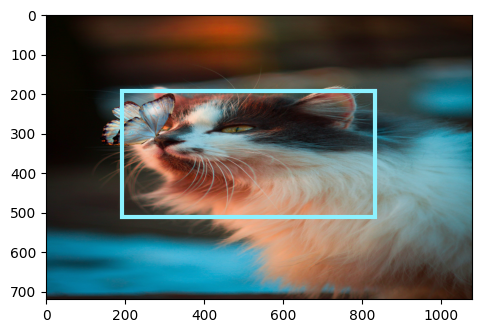

In [72]:
# show detected object using CLIP with bounding box

detect([query], img, window=4, stride=1)

---